# Application Programming Interface (API)

Uma API (Interface de Programacao de Aplicacoes) e um conjunto de regras/contrato que expõe funcionalidades e dados de um sistema para outro, sem exigir que um conheça a implementação interna do outro. Ela funciona como um "mensageiro" ou uma ponte entre diferentes softwares.

Por exemplo, imagine que voce esta comprando uma entrada para o cinema num aplicativo de ingressos:

- O aplicativo de ingressos precisa saber quais assentos estão livres, mas ele nao e dono do sistema do cinema.
- O aplicativo envia uma mensagem (via API) para o sistema do cinema perguntando quais assentos estao disponiveis.
- O sistema responde rapidamente com a disponibilidade de assentos naquele instante.

Entao, e como se voce estivesse em um restaurante:
- Voce e o **sistema** que faz os pedidos
- A **cozinha** e o sistema que prepara os dados
- A **API** e o garcom que leva seu pedido ate a cozinha e traz o prato de volta pra voce.

# Como as coisas funcionavam antes das APIs modernas
Antes da popularizacao das **APIs web/HTTP** (como REST), a integração entre sistemas era muito mais rigida, lenta e "manual". APIs ja existiam em forma de bibliotecas ou RPC, mas a web tornou esse padrao muito mais acessivel e padronizado.

- **Compartilhamento de Bancos de Dados**: Frequentemente, dois sistemas diferentes precisavam acessar o mesmo banco de dados. Se um sistema mudasse a estrutura de uma tabela, o outro parava de funcionar instantaneamente.

- **Troca de Arquivos (Batch)**: Era comum gerar arquivos enormes (como CSV ou TXT) no final do dia e envia-los via FTP para outro servidor. A informacao nunca era em tempo real.

- **Codigo Acoplado**: Se voce quisesse usar uma funcionalidade de outro software, muitas vezes precisava copiar partes do codigo ou instalar bibliotecas complexas que tornavam o sistema pesado e dificil de manter.

# Por que APIs melhoram as coisas?
- **Padronizacao**: As APIs usam formatos universais (como JSON ou XML), permitindo que um aplicativo de iPhone (escrito em Swift) fale facilmente com um servidor rodando Linux (escrito em Python).
- **Seguranca**: Voce nao precisa abrir seu banco de dados para estranhos. A API entrega apenas o que foi solicitado, agindo como uma camada de protecao.
- **Agilidade e Escalabilidade**: Desenvolvedores nao precisam "reinventar a roda". Se voce precisa de um mapa no seu app, voce usa a API do Google Maps em vez de mapear o mundo sozinho.

# Creating a FastAPI application

```py
BOOKS = [
    {'title': 'Title One', 'author': 'Author One','category': 'science'},
    {'title': 'Title Two', 'author': 'Author Two','category': 'science'},
    {'title': 'Title Three', 'author': 'Author Three','category': 'history'},
    {'title': 'Title Four', 'author': 'Author Four','category': 'math'},
    {'title': 'Title Five', 'author': 'Author Five','category': 'math'},
    {'title': 'Title Six', 'author': 'Author Two', 'category': 'math'}
]
```

In [ ]:
# main.py
from fastapi import FastAPI

app = FastAPI()

@app.get('/api-endpoint')
async def first_api():
    return {'message':'Hello!'}

O que acabamos de fazer foi um **endpoint** **HTTP GET** básico de uma API.

- Para rodarmos isso **em fase de densevolvimento** usamos:

```bash
    py -m uvicorn books:app --reload
```

``--reload`` faz com que o servidor ``uvicorn`` seja recarregado sempre que houver alterações em arquivos salvos.

- Ou ainda, para **modo de produção** rode com:

```bash
    py -m fastapi run books.py
```

- Para **modo de desenvolvimento** também podemos rodar com:

```bash
    py -m fastapi dev books.py
```


# First End Point (/books)

In [ ]:
from fastapi import FastAPI

app = FastAPI()

BOOKS = [
    {'title': 'Title One', 'author': 'Author One','category': 'science'},
    {'title': 'Title Two', 'author': 'Author Two','category': 'science'},
    {'title': 'Title Three', 'author': 'Author Three','category': 'history'},
    {'title': 'Title Four', 'author': 'Author Four','category': 'math'},
    {'title': 'Title Five', 'author': 'Author Five','category': 'math'},
    {'title': 'Title Six', 'author': 'Author Two', 'category': 'math'}
]

@app.get('/books')
async def read_all_books():
    return BOOKS

# Path Parameters ( Parâmetros de Caminho )

In [ ]:
@app.get('/books/{dynamic_param}')
async def read_all_books(dynamic_param):
    return {'dynamic_param':dynamic_param}

## Endpoints Estáticos na frente de Endpoints Dinâmicos

In [ ]:
# rota dinâmica
@app.get('/book/{dynamica_param}')
async def read_all_books(dynamic_param):
    return {'dynamic_param':dynamic_param}

# rota estática
@app.get('/book/my_book')
async def read_all_books():
    return {'book_title':'My Favorite Book'}

O **FastAPI** lê os arquivos em ordem, de cima para baixo, procurando o que bate com a **URL** da requisição. 

Assim, para algo como ``127.0.0.1:8000/books/mybook`` a segunda função nunca vai ser chamada porque a primeira função está aceitando exatamente a mesma lista de parâmetros. Portanto, o que devemos fazer é manter as rotas estáticas ( ou menores ) na frente das dinâmicas.

Portanto, o correto seria:

In [ ]:
# rota estática
@app.get('/book/my_book')
async def read_all_books():
    return {'book_title':'My Favorite Book'}

# rota dinâmica
@app.get('/book/{dynamica_param}')
async def read_all_books(dynamic_param):
    return {'dynamic_param':dynamic_param}

## Rota para um Livro específico

In [ ]:
@app.get('/book/{book_title}')
async def read_book(book_title: str):
    for book in BOOKS:
        if book.get('title').casefold() == book_title.casefold():
            return book

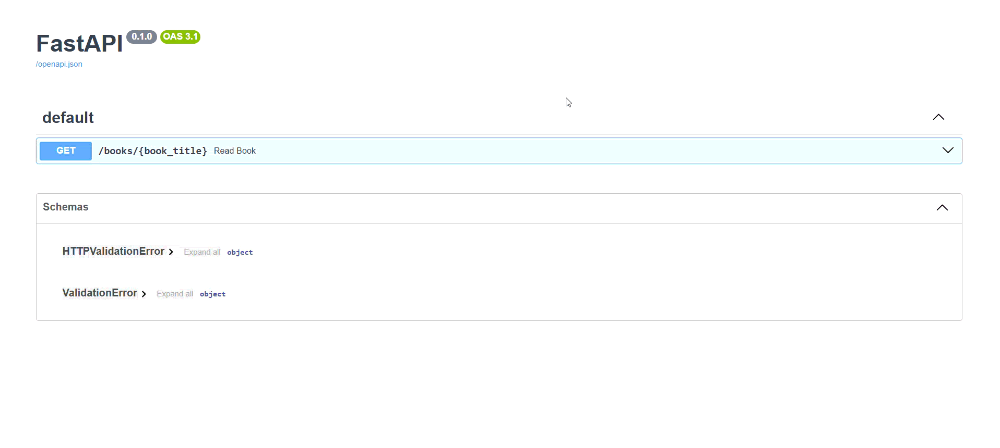